# Third attempt at linear regression model to explain global sales

In [2]:
import pandas as pd
import pandas_profiling
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import statsmodels.api as sm
from statsmodels.graphics.gofplots import ProbPlot
from scipy import stats

In [3]:
%matplotlib inline

In [4]:
sales_joined = pd.read_csv("../clean_data/sales-joined.csv")

## Exploration

In [3]:
sales_joined.describe()

,rank,global_sales,na_sales,pal_sales,jp_sales,other_sales,year,critic_score,user_score
count,19834.000000,19834.000000,12773.000000,12123.000000,6768.000000,14499.000000,19834.000000,7952.000000,7384.00000
mean,9925.223303,0.531601,0.279823,0.168910,0.114507,0.047903,2007.403953,68.954351,7.13402
std,5733.868603,1.573721,0.515766,0.413661,0.187010,0.133507,25.495746,13.966903,1.49996
min,1.000000,0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,13.000000,0.00000
25%,4959.250000,0.050000,0.050000,0.020000,0.020000,0.000000,2004.000000,60.000000,6.40000
50%,9923.500000,0.160000,0.120000,0.050000,0.050000,0.010000,2008.000000,71.000000,7.50000
75%,14888.750000,0.450000,0.290000,0.160000,0.130000,0.040000,2012.000000,79.000000,8.20000
max,19862.000000,82.860000,9.760000,9.850000,2.690000,3.120000,2020.000000,98.000000,9.70000


Potential issues:
- outliers in sales columns
- rows with year == 0
- distribution of critic and user scores

In [5]:
pandas_profiling.ProfileReport(sales_joined)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [5]:
# remove certain games that were bundled with consoles
sales_joined = sales_joined.loc[sales_joined["name"] != "Wii Sports"]
sales_joined = sales_joined.loc[sales_joined["name"] != "Super Mario Bros."]

In [7]:
sales_joined.columns

Index(['rank', 'name', 'genre', 'esrb_rating', 'platform', 'publisher',
       'developer', 'global_sales', 'na_sales', 'pal_sales', 'jp_sales',
       'other_sales', 'year', 'critic_score', 'user_score'],
      dtype='object')

In [6]:
# drop columns we won't be needing
sales_joined.drop(['rank', 'name', 'esrb_rating', 'publisher', 'developer', 'year'], axis=1, inplace=True)

In [18]:
# remove three rows where year is 0
sales_joined = sales_joined.loc[sales_joined["year"] != 0]

In [21]:
sales_joined.describe()

,global_sales,na_sales,pal_sales,jp_sales,other_sales,year,critic_score,user_score
count,19829.000000,12773.000000,12121.000000,6767.000000,14496.000000,19829.000000,7950.000000,7382.000000
mean,0.525521,0.279823,0.168932,0.114518,0.047913,2007.708861,68.956352,7.133839
std,1.433802,0.515766,0.413691,0.187022,0.133519,6.354889,13.966064,1.500120
min,0.010000,0.000000,0.000000,0.000000,0.000000,1970.000000,13.000000,0.000000
25%,0.050000,0.050000,0.020000,0.020000,0.000000,2004.000000,60.000000,6.400000
50%,0.160000,0.120000,0.050000,0.050000,0.010000,2008.000000,71.000000,7.500000
75%,0.450000,0.290000,0.160000,0.130000,0.040000,2012.000000,79.000000,8.200000
max,37.140000,9.760000,9.850000,2.690000,3.120000,2020.000000,98.000000,9.700000


In [22]:
pandas_profiling.ProfileReport(sales_joined)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

There are many columns with a substantial amount of missing values. We will be replacing the missing values with the the associated variable's mean.

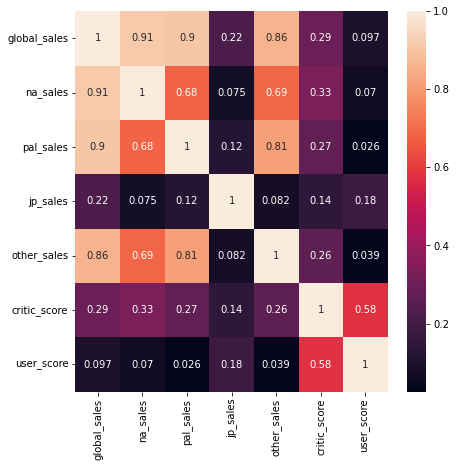

In [7]:
# look at correlation and plot heatmap
correlation = sales_joined.corr()
plt.figure(figsize=(7,7))
sns.heatmap(correlation, annot=True);

In [8]:
correlation["global_sales"].sort_values(ascending=False)

global_sales    1.000000
na_sales        0.914597
pal_sales       0.903237
other_sales     0.855725
critic_score    0.294627
jp_sales        0.221730
user_score      0.097206
Name: global_sales, dtype: float64

Strong correlation between na/pal sales and global sales, could potentially indicate that a game that performs well in North America or Europe is likely to perform well globally.

Also interesting to note that critic scores are more correlated to global sales than user scores are.

<Figure size 504x504 with 0 Axes>

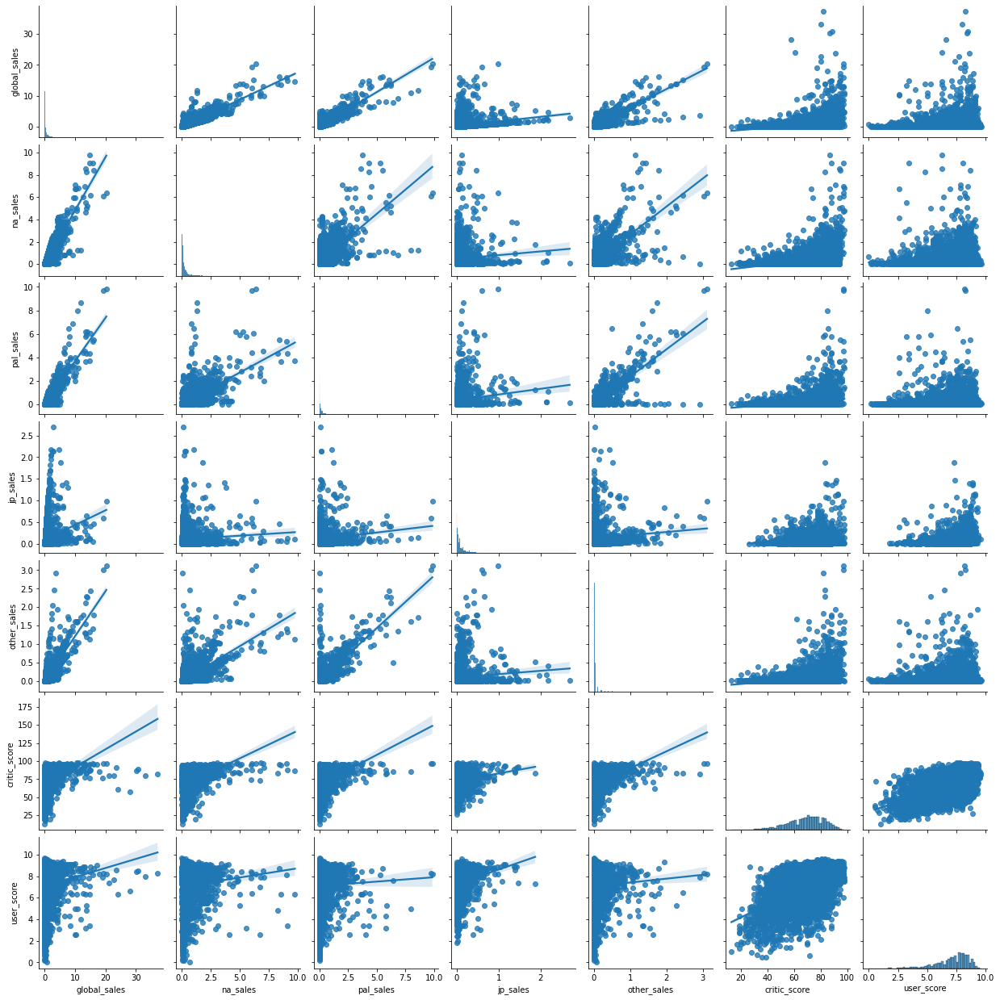

In [9]:
# variable distribution
plt.figure(figsize=(7,7))
sns.pairplot(sales_joined, kind="reg");

All sales columns appear to be heavily right skewed. Critic and user score looks better, but left skewed. Outliers to deal with in many columns.

In [11]:
# look at skewness per column
for column in sales_joined[['global_sales', 'na_sales', 'pal_sales', 'jp_sales', 'other_sales', \
                           'critic_score', 'user_score']].columns.values.tolist():
    print(column)
    print(sales_joined[column].skew())
    print()

global_sales
10.557045267510425

na_sales
6.4345944256865355

pal_sales
8.787521894251475

jp_sales
4.569339717984006

other_sales
9.084804765134738

critic_score
-0.6103350214022549

user_score
-1.2543973379543365



Most of the columns are heavily skewed, with a skewness magnitude higher than 1.

critic_score is moderately left skewed.

In [13]:
# look at distribution for each variable
for column in sales_joined[['global_sales', 'na_sales', 'pal_sales', 'jp_sales', 'other_sales', \
                           'critic_score', 'user_score']]:
    fig=px.histogram(sales_joined, x=sales_joined[column])
    fig.show();

In [14]:
# boxplot distribution for each variable
for column in sales_joined[['global_sales', 'na_sales', 'pal_sales', 'jp_sales', 'other_sales', \
                           'critic_score', 'user_score']]:
    fig=px.box(sales_joined, x=sales_joined[column])
    fig.show();

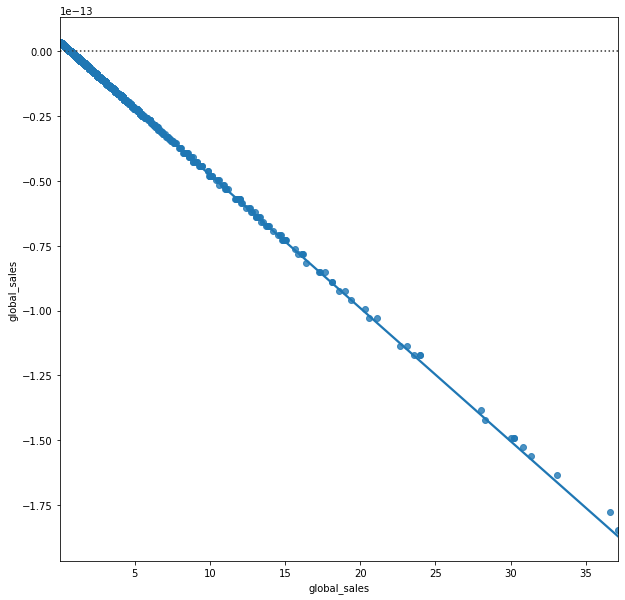

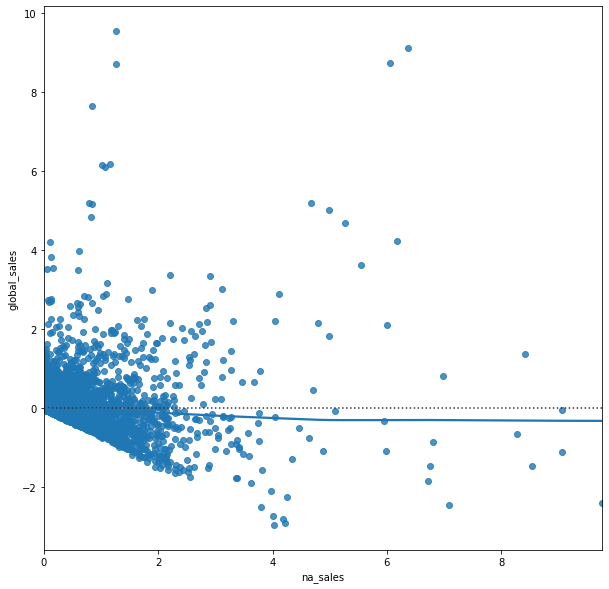

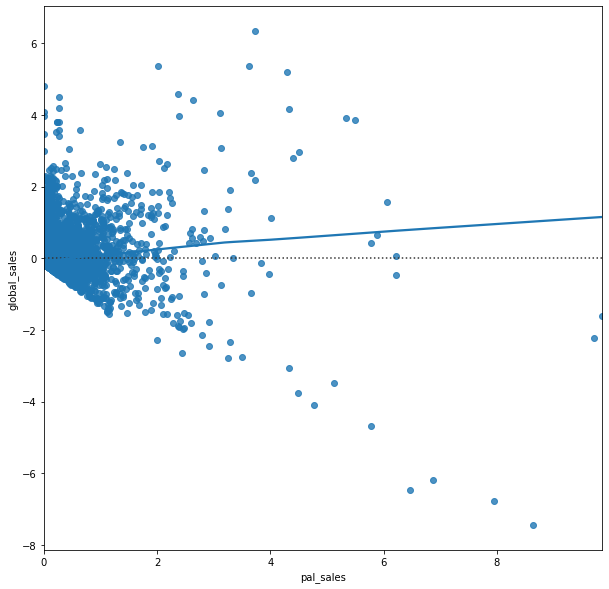

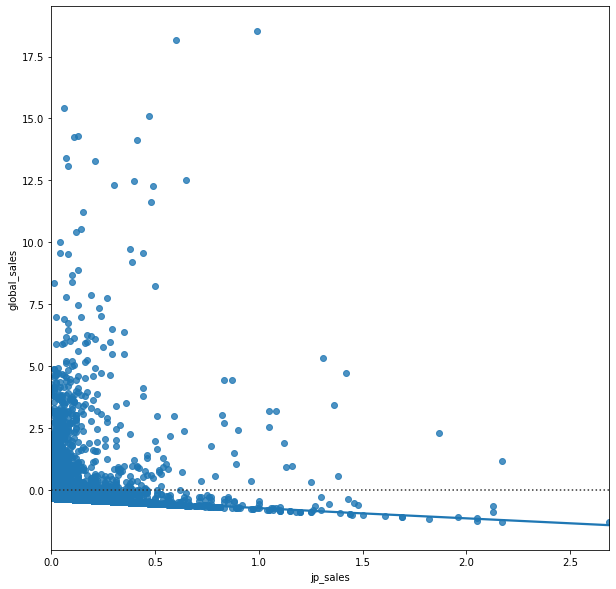

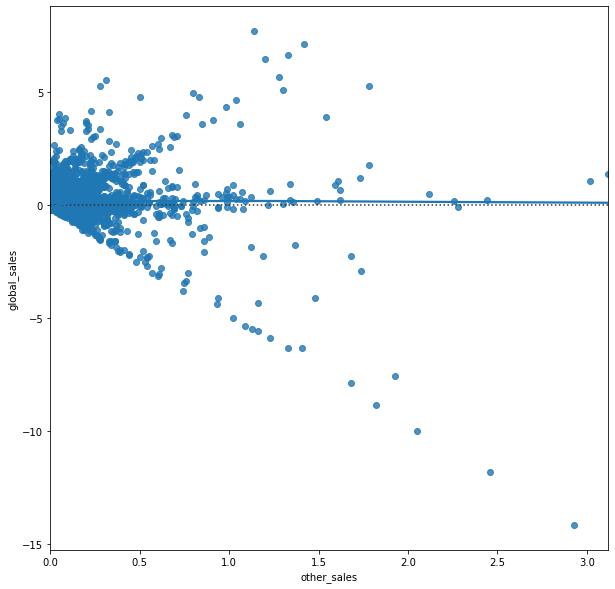

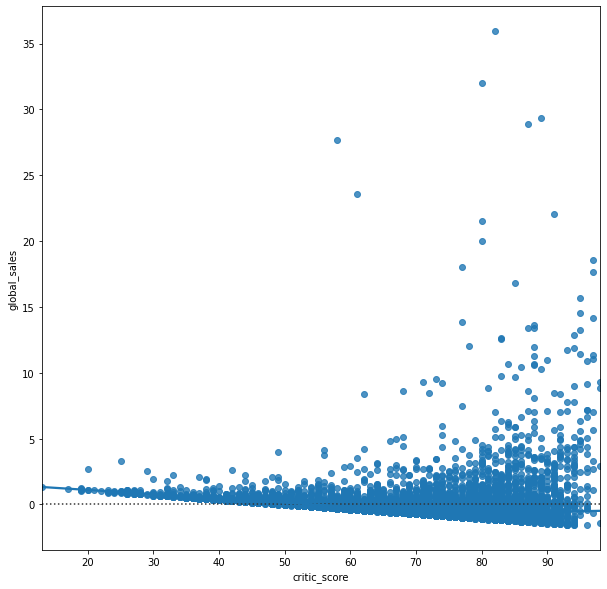

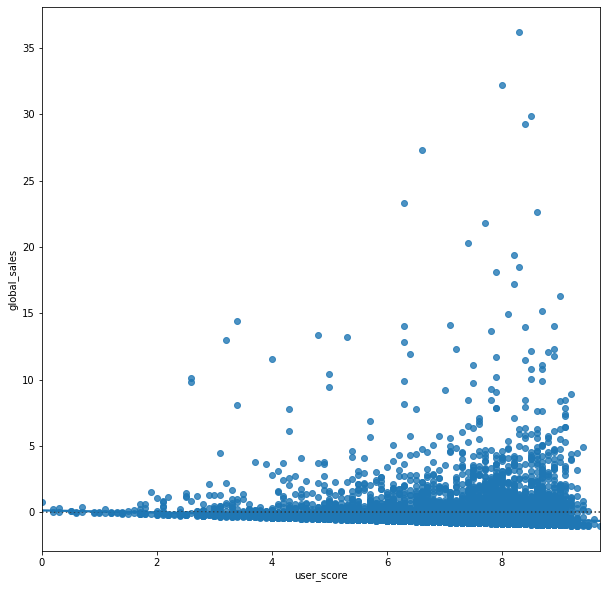

In [15]:
# look at residuals
for column in sales_joined[['global_sales', 'na_sales', 'pal_sales', 'jp_sales', 'other_sales', \
                           'critic_score', 'user_score']]:
    plt.figure(figsize=(10,10))
    sns.residplot(x=sales_joined[column], y=sales_joined["global_sales"], data=sales_joined, lowess=True)

## Cleaning

In [16]:
# replace NaNs with mean of each variable
sales_clean = sales_joined.copy()

mean_1 = sales_clean["na_sales"].mean(axis=0)
mean_2 = sales_clean["pal_sales"].mean(axis=0)
mean_3 = sales_clean["jp_sales"].mean(axis=0)
mean_4 = sales_clean["other_sales"].mean(axis=0)
mean_5 = sales_clean["critic_score"].mean(axis=0)
mean_6 = sales_clean["user_score"].mean(axis=0)

sales_clean["na_sales"].replace(np.nan, mean_1, inplace=True)
sales_clean["pal_sales"].replace(np.nan, mean_2, inplace=True)
sales_clean["jp_sales"].replace(np.nan, mean_3, inplace=True)
sales_clean["other_sales"].replace(np.nan, mean_4, inplace=True)
sales_clean["critic_score"].replace(np.nan, mean_5, inplace=True)
sales_clean["user_score"].replace(np.nan, mean_6, inplace=True)

In [17]:
sales_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 19832 entries, 2 to 19833
Data columns (total 9 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   genre         19832 non-null  object 
 1   platform      19832 non-null  object 
 2   global_sales  19832 non-null  float64
 3   na_sales      19832 non-null  float64
 4   pal_sales     19832 non-null  float64
 5   jp_sales      19832 non-null  float64
 6   other_sales   19832 non-null  float64
 7   critic_score  19832 non-null  float64
 8   user_score    19832 non-null  float64
dtypes: float64(7), object(2)
memory usage: 1.5+ MB


In [19]:
# find and remove outliers
z = np.abs(stats.zscore(sales_clean[['global_sales', 'na_sales', 'pal_sales', 'jp_sales', 'other_sales', \
                           'critic_score', 'user_score']]))
filtered = (z<3).all(axis=1)
sales_3 = sales_clean[filtered]
sales_3.head()

,genre,platform,global_sales,na_sales,pal_sales,jp_sales,other_sales,critic_score,user_score
278,Adventure,Nintendo DS,4.76,0.279823,0.16891,0.114507,0.047903,90.000000,8.000000
282,MMO,PC,4.70,0.279823,0.16891,0.114507,0.047903,90.000000,5.600000
285,Racing,PlayStation Portable,4.67,0.279823,0.16891,0.114507,0.047903,68.953465,7.133902
288,Action,PlayStation 2,4.62,0.279823,0.16891,0.114507,0.047903,94.000000,8.900000
289,Adventure,SNES,4.61,0.279823,0.16891,0.114507,0.047903,68.953465,7.133902


<Figure size 504x504 with 0 Axes>

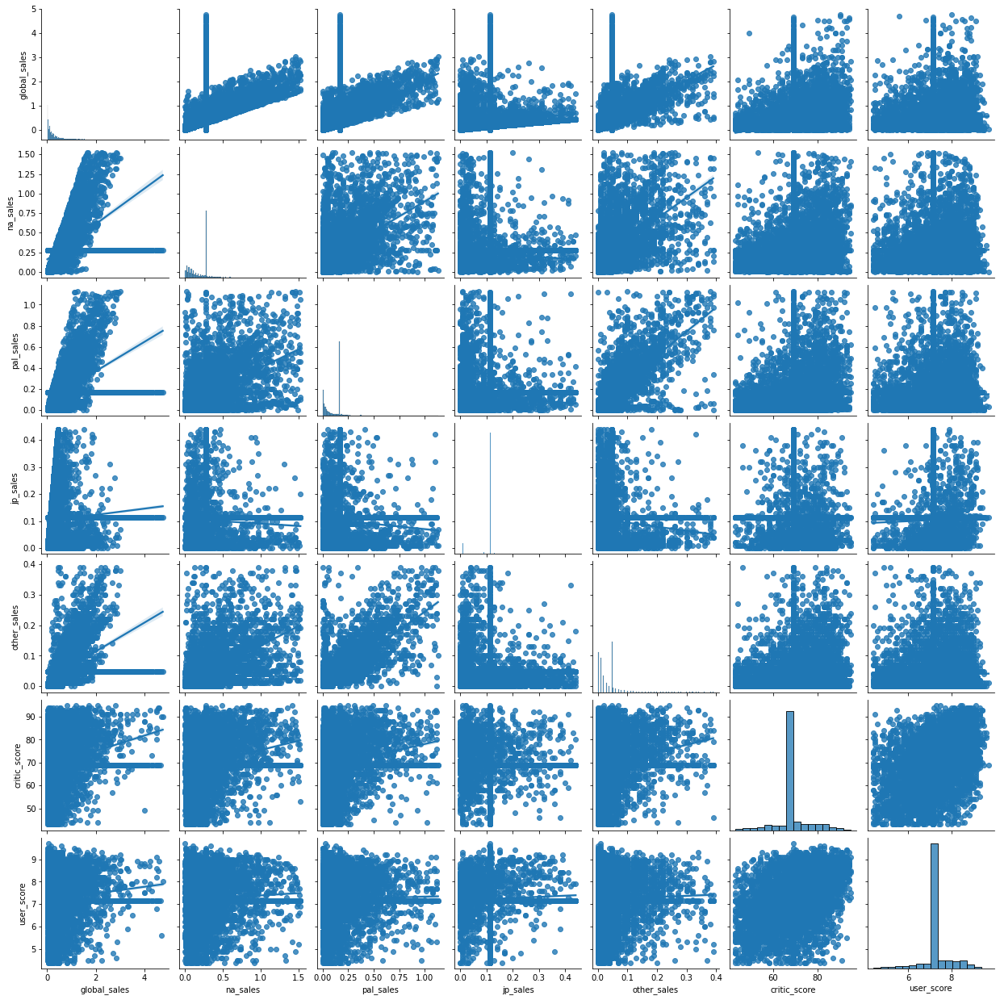

In [20]:
# look at skewness again
plt.figure(figsize=(7,7))
sns.pairplot(sales_3, kind="reg");

Not ideal but looks better.

## Model building

In [21]:
sales_3

,genre,platform,global_sales,na_sales,pal_sales,jp_sales,other_sales,critic_score,user_score
278,Adventure,Nintendo DS,4.76,0.279823,0.16891,0.114507,0.047903,90.000000,8.000000
282,MMO,PC,4.70,0.279823,0.16891,0.114507,0.047903,90.000000,5.600000
285,Racing,PlayStation Portable,4.67,0.279823,0.16891,0.114507,0.047903,68.953465,7.133902
288,Action,PlayStation 2,4.62,0.279823,0.16891,0.114507,0.047903,94.000000,8.900000
289,Adventure,SNES,4.61,0.279823,0.16891,0.114507,0.047903,68.953465,7.133902
...,...,...,...,...,...,...,...,...,...
19829,Simulation,PC,0.01,0.279823,0.00000,0.114507,0.000000,68.953465,7.133902
19830,Shooter,PC,0.01,0.279823,0.00000,0.114507,0.000000,68.953465,7.133902
19831,Fighting,PlayStation 2,0.01,0.279823,0.16891,0.010000,0.047903,68.953465,7.133902
19832,Adventure,PlayStation Vita,0.01,0.279823,0.16891,0.010000,0.047903,68.953465,7.133902


In [22]:
# create dummy variables
sales_3 = pd.get_dummies(sales_3, drop_first = True)

In [23]:
# set response array 
y = sales_3["global_sales"]

# put predictors in a data frame
X = sales_3.drop(columns = "global_sales")

In [24]:
# model
model_1 = sm.OLS(y, X).fit()
model_1.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:           global_sales   R-squared (uncentered):                   0.660
Model:                            OLS   Adj. R-squared (uncentered):              0.659
Method:                 Least Squares   F-statistic:                              664.5
Date:                Thu, 02 Jun 2022   Prob (F-statistic):                        0.00
Time:                        12:51:38   Log-Likelihood:                         -7097.4
No. Observations:               18186   AIC:                                  1.430e+04
Df Residuals:                   18133   BIC:                                  1.471e+04
Df Model:                          53                                                  
Covariance Type:            nonrobust                                                  
=================================================================================================
                                    coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
na_sales                          0.7438      0.018     42.439      0.000       0.709       0.778
pal_sales                         0.7087      0.031     23.019      0.000       0.648       0.769
jp_sales                          1.0544      0.051     20.635      0.000       0.954       1.155
other_sales                       3.2731      0.108     30.353      0.000       3.062       3.484
critic_score                      0.0033      0.000      7.820      0.000       0.002       0.004
user_score                        0.0092      0.004      2.149      0.032       0.001       0.018
genre_Action-Adventure            0.0170      0.022      0.772      0.440      -0.026       0.060
genre_Adventure                  -0.0927      0.011     -8.324      0.000      -0.115      -0.071
genre_Board Game                 -0.0893      0.254     -0.351      0.725      -0.588       0.409
genre_Education                  -0.2441      0.207     -1.180      0.238      -0.650       0.161
genre_Fighting                    0.0031      0.014      0.218      0.827      -0.025       0.031
genre_MMO                         0.4360      0.055      7.887      0.000       0.328       0.544
genre_Misc                       -0.0845      0.011     -7.978      0.000      -0.105      -0.064
genre_Music                      -0.0393      0.032     -1.243      0.214      -0.101       0.023
genre_Party                       0.1970      0.061      3.216      0.001       0.077       0.317
genre_Platform                    0.0577      0.013      4.325      0.000       0.032       0.084
genre_Puzzle                     -0.0616      0.016     -3.936      0.000      -0.092      -0.031
genre_Racing                     -0.0142      0.012     -1.160      0.246      -0.038       0.010
genre_Role-Playing                0.0208      0.011      1.838      0.066      -0.001       0.043
genre_Sandbox                    -0.1854      0.160     -1.155      0.248      -0.500       0.129
genre_Shooter                     0.0011      0.012      0.095      0.924      -0.023       0.025
genre_Simulation                 -0.0549      0.013     -4.161      0.000      -0.081      -0.029
genre_Sports                     -0.0619      0.010     -5.933      0.000      -0.082      -0.041
genre_Strategy                   -0.0797      0.015     -5.428      0.000      -0.108      -0.051
genre_Visual Novel               -0.1763      0.035     -4.989      0.000      -0.246      -0.107
platform_Game Boy                 0.1058      0.049      2.160      0.031       0.010       0.202
platform_Game Boy Advance        -0.3312      0.027    -12.165      0.000      -0.385      -0.278
platform_Game Boy Color           1.1533    